In [14]:
import pandas as pd
import plotly.express as px

df = pd.read_csv('../hanro_test/0407/03_Data.csv')
print(df1.shape)
df.head(2)

(4285, 11)


,Unnamed: 0,회원번호,회원상태,성별,결혼유무,주소,연령,총구매금액,총구매수량,총방문횟수
0,0,2101,정상회원,여,기혼,서울 강북구 미아동 134-,51,1991230,382.0,86
1,1,2102,정상회원,여,NaN,경기 용인시 수지구 동천동,71,2095860,472.5,79


In [16]:
# 1. '총구매금액'을 '총방문횟수'로 나누어, '1회방문구매평균'을 계산하고, 생성된 파생변수를 바탕으로 아래와 같이 고객등급을 분류하시오.
# - '1회방문구매평균'이 10만원 이상 고객은 A / 5만원 이상은 B / 2만원 이상 C / 나머지는 D 등급으로 분류
# - 분류된 고객 등급은 '고객등급'이라는 새로운 파생변수로 생성

def func(row):
    if pd.isnull(row):
        return "D"
    if row >= 100000:
        return "A"
    elif row >= 50000:
        return "B"
    elif row >= 20000:
        return "C"
    else:
        return "D"

df['1회방문구매평균'] = df['총구매금액'] / df['총방문횟수']
df['고객등급'] = df['1회방문구매평균'].apply(func)
df['고객등급'].value_counts()

고객등급
C    2006
D    1506
B     676
A      97
Name: count, dtype: int64

In [17]:
cond = df['결혼유무'] == '기혼'
new_df = df.loc[cond]['고객등급']
new_df.value_counts()

고객등급
C    812
D    598
B    315
A     50
Name: count, dtype: int64

In [22]:
# 2. 새로 생성된 파생변수 '고객등급'에서 '기혼자가 가장 많은 그룹은 어디 그룹인지 확인하시오.
list1 = df['고객등급'].unique()

for i in list1:
    cond1 = df['고객등급'] == i
    cond0 = df['결혼유무'] == '기혼'
    print(i, df.loc[cond1 & cond0].shape[0])

C 812
B 315
A 50
D 598


In [25]:
# crosstab 함수 : 범주형 항목간의 빈도수를 계산

pd.crosstab(df['고객등급'], df['결혼유무']).sort_values(by = '기혼', ascending = False)

결혼유무,기혼,미혼
고객등급,,
C,812,751
D,598,580
B,315,226
A,50,28


In [27]:
# 3. df3 데이터에서 '주소'데이터를 바탕으로, "시" 별 '지역(시)'이라는 이름의 새로운 파생변수를 생성 하고,
# '지역(시)'의 데이터 비율을 계산하시오.
# - 서울시 / 용인시 / 성남시 /수원시 /광주시 / 나머지 지역은 기타로 분류

def func_si(row):
    line = list(row.split())
    if line[0] == "서울":
        return "서울시"
    elif line[1] in ["용인시", "성남시", "수원시", "광주시"]:
        return line[1]
    else:
        return "기타"

df["지역(시)"] = df["주소"].apply(func_si)
df['지역(시)'].value_counts() / len(df)

지역(시)
용인시    0.505718
서울시    0.175963
기타     0.129988
성남시    0.127655
수원시    0.048075
광주시    0.012602
Name: count, dtype: float64

In [29]:
# 4. '고객등급'을 입력했을 때, 해당 고객등급에서 '성별'에 따른 '총구매금액' 기술통계량을 계산하여 
# 'result9_등급명.xlsx'저장하는 프로그램을 구성 하시오.

def func3(rank):
    cond1 = df['고객등급'] == rank
    return df.loc[cond1].pivot_table(index = '성별', values = '총구매금액', aggfunc = ['median', 'mean', 'std', 'min', 'max', 'sum'])

func3('C')

,median,mean,std,min,max,sum
,총구매금액,총구매금액,총구매금액,총구매금액,총구매금액,총구매금액
성별,,,,,,
남,236775.0,520717.102804,7.154131e+05,20750,4975460,111433460
여,315900.0,978205.465402,1.414233e+06,20000,8394730,1752944194


In [30]:
df_product = pd.read_csv('data/03_store_product.csv')
print(df_product.shape)
df_product.head(2)

(735783, 11)


,공급일자,물품코드,물품대분류,물품중분류,물품소분류,물품명,구매수량,구매금액,구매매장,반품_원거래일자,회원번호
0,20220201,50142001,채소,잎/줄기채소,시금치,시금치(300g),1.0,2000,매장3,NaN,2101.0
1,20220201,60302012,축산물,육가공,돈가스/분쇄가공,튀김옷돈가스(400g),1.0,6300,매장3,NaN,2101.0


In [44]:
# 5.  각 회원 별 ‘물품대분류’에서 각 물품을 어느 정도 비중으로 구매했는지 계산하고자 한다.
# df_product (03_store_product.csv)에서, ‘물품대분류’의 항목을 확인하고, 
# ‘회원번호’ 별 ‘물품 대분류의 구매수량을 계산한 후, 
# 한명의 회원이 구매한 전체 수량으로 나누어 각 품목 별 구매 비율을 계산해 아래와 같이 df3에 병합하시오.

p1 = df_product.pivot_table(index = '회원번호', columns = '물품대분류',
                            values = '구매수량', aggfunc = 'sum',
                            fill_value = 0, margins =  True)
for i in p1.columns:
    p1[i + "_Rate"] = p1[i] / p1['All']
name_list = [x for x in p1.columns if '_Rate' in x]
p2 = p1[name_list[:-1]].iloc[:-1].reset_index() # 맨 아래 행 회원번호 All reset

df2 = pd.merge(df1, p2, on = '회원번호', how = 'inner')
print(df2.shape)
df2.head(2)

(4285, 28)


,Unnamed: 0,회원번호,회원상태,성별,결혼유무,주소,연령,총구매금액,총구매수량,총방문횟수,...,생활용품_Rate,서류_Rate,수산_Rate,양념/가루_Rate,음료_Rate,잡곡_Rate,주곡_Rate,주류_Rate,채소_Rate,축산물_Rate
0,0,2101,정상회원,여,기혼,서울 강북구 미아동 134-,51,1991230,382.0,86,...,0.020942,0.015707,0.010471,0.039267,0.026178,0.013089,0.005236,0.0,0.308901,0.251309
1,1,2102,정상회원,여,NaN,경기 용인시 수지구 동천동,71,2095860,472.5,79,...,0.006349,0.023280,0.050794,0.035979,0.014815,0.010582,0.033862,0.0,0.220106,0.107937


In [64]:
p1 = df_product.pivot_table(index = '회원번호', columns = '물품대분류',
                            values = '구매수량', aggfunc = 'sum',
                            fill_value = 0, margins =  True).reset_index()
p1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4286 entries, 0 to 4285
Data columns (total 19 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   회원번호    4286 non-null   object 
 1   간식      4286 non-null   float64
 2   건강      4286 non-null   float64
 3   과실      4286 non-null   float64
 4   급식용     4286 non-null   float64
 5   기타      4286 non-null   float64
 6   반찬      4286 non-null   float64
 7   베이커리    4286 non-null   float64
 8   생활용품    4286 non-null   float64
 9   서류      4286 non-null   float64
 10  수산      4286 non-null   float64
 11  양념/가루   4286 non-null   float64
 12  음료      4286 non-null   float64
 13  잡곡      4286 non-null   float64
 14  주곡      4286 non-null   float64
 15  주류      4286 non-null   float64
 16  채소      4286 non-null   float64
 17  축산물     4286 non-null   float64
 18  All     4286 non-null   float64
dtypes: float64(18), object(1)
memory usage: 636.3+ KB


In [45]:
# 6. df_product데이터의 구조와 타입을 확인 하시오.
df_product.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 735783 entries, 0 to 735782
Data columns (total 11 columns):
 #   Column    Non-Null Count   Dtype  
---  ------    --------------   -----  
 0   공급일자      735783 non-null  int64  
 1   물품코드      735783 non-null  int64  
 2   물품대분류     735783 non-null  object 
 3   물품중분류     735783 non-null  object 
 4   물품소분류     735783 non-null  object 
 5   물품명       735783 non-null  object 
 6   구매수량      735783 non-null  float64
 7   구매금액      735783 non-null  int64  
 8   구매매장      735783 non-null  object 
 9   반품_원거래일자  10337 non-null   float64
 10  회원번호      735761 non-null  float64
dtypes: float64(3), int64(3), object(5)
memory usage: 61.7+ MB


In [48]:
# 7. df_product데이터의'물품대분류' 중 가장 많이 판매되는(수량)3가지 항목을 추출하여, df_product_top이라는 변수로 선언하고,
# df_product_top에서 '구매매장'별 '구매금액'의 합과 평균을 계산 하시오.


p_list = df_product.pivot_table(index = '물품대분류', values = '구매수량', aggfunc = 'sum').sort_values(by = '구매수량', ascending = False).index
df_product_top = df_product.loc[df_product['물품대분류'].isin(p_list[:3])]
df_product_top.pivot_table(index = '구매매장', values = '구매금액', aggfunc = ['sum', 'mean'])

,sum,mean
,구매금액,구매금액
구매매장,,
매장1,363985400,4770.638426
매장2,461745602,4908.271082
매장3,916748142,4949.910326
매장4,419048570,5019.146844


In [65]:
# 8. 공급일자'데이터를 날짜형식으로 변환하여, '연도' / '월' / '요일' 항목을 새로운 파생변수로 생성하시오.

df_product['datetime'] = pd.to_datetime(df_product['공급일자'], format='%Y%m%d')
df_product['연도'] = df_product['datetime'].dt.year
df_product['월'] = df_product['datetime'].dt.month
df_product['요일'] = df_product['datetime'].dt.day_name()
df_product['datetime'].describe()

count                           735783
mean     2022-04-02 14:26:01.441892864
min                2022-01-02 00:00:00
25%                2022-02-17 00:00:00
50%                2022-04-03 00:00:00
75%                2022-05-19 00:00:00
max                2022-06-30 00:00:00
Name: datetime, dtype: object

In [10]:
# 9. '월'에 따른'물품대분류'별 '구매금액'의 합을 게산하여 result8.xlsx저장 하시오.

df_product.pivot_table(index = '월', columns = '물품대분류', values = '구매금액', aggfunc = 'sum')

In [69]:
# 10. '요일'에서 '주말'과'주중'을 구분하여, '주중'과 '주말'의 구매수량의 합을 확인하시오.

day_name_list = df_product['요일'].unique()
weekend_list = ['주중', '주중', '주중', '주중', '주말', '주말', '주중']
weekend_label = dict(zip(day_name_list, weekend_list))
df_product['주말여부'] = df_product['요일'].replace(weekend_label)

In [72]:
df_product['주말여부'].value_counts()

주말여부
주중    545137
주말    190646
Name: count, dtype: int64

# 10. 확증적 데이터 분석

- 데이터 간 연관성, 상관성, 유사성 등을 가설로 수립하여, 객관적인 수치로 검증
- 통계적 가설 검정 기법을 이용해 검정실시
- 통계적 가설 검정은 **확률분포**를 기반으로 가설검정이 수행
- **확률분포 (Probability Distribution)** 는 확률 변수가 취할 수 있는 값들과 그러한 값을 취할 가능성(확률)을 그래프나 표, 함수를 이용해 나타낸 것
- 확률 분포를 파악해야 하는 이유는 데이터의 분포의 종류에 따라 가설 검정 기법이 달라짐

## 10-1. 확률 분포 (Probability Distribution)

**계량형 확률 분포**
  - 계량형은 실험의 결과(사건의 결과)가 연속형 값을 취하는 상황을 모형화 하기 위해 사용
  - 숫자, 연속형 데이터 -> 계량형 데이터

1. 정규분포 (Normal Distribution) : 연속형 확률 변수 X가 (데이터가) 우연적 상태에서 무한히 집합 할 때, 주심값 근처에 대다수의 데이터가 밀집되어, 좌우 대칭의 종모양의 분포가 형성되는데, 이러한 분포를 정규분포
   - 일반적인 연속형 데이터들이 갖는 분포
   - 용도는 수집된 자료의 분포를 근사하는데 사용되며, 이는 중심극한정리에 의해 독립적인 변수의 평균이 정규분포에 가까워지는 성질에 의해 모집단을 추정하는데에 사용
   - 중심 극한 정리 (Cental Limit Theorem) : 모집단으로 부터 얻은 표본 평균에 대해, 모평균과 모분산을 알면, 표본의 평균과 표본의 분산 및 표준편차를 알 수 있다. 이때, 추출한 표본의 수가 충분히 크다면, 표본평균은 정규분포를 근사적으로 따름
   - 표준정규분포(Standard Normal Distribution) : 평균이 0이고, 표준편차가 1인 형태의 분포(Z분포) , 스케일링 작업을 수행할 때 사용

2. T 분포(T Distribution) : 정규분포의 평균을 측정하기 위해 고안된 분포, 정규분포와 유사하지만, 표본의 크기에 따라서 꼬리부분이 더 두꺼운 모습을 가진 분포
   - 용도는 현재 가진 데이터를 표본으로 가정했을 때, 모집단의 평균을 추정하거나 검정할 때 사용
   - 표준정규분포와 유사하게 0을 중심으로 좌우가 대칭
   - 모집단에 대한 정보(대표값, 산포)가 없을 때 사용하는 분포

3. 카이제곱분포(Chi² Distribution) : 정규분포를 따르는 모집단에서 크기가 n인 표본을 무작위로 반복하여 추출했을 때, 각 표본에 대해 계산한 표본 분산들이 띄는 분포
   - 용도는 모집단의 분산을 추정하거나, 비도기반의 분포 또는 형태 적합도를 검정, 여러 집단 간 독립성, 동질성 검정 수행할 때 사용
  
4. F 분포 (F Distribution) : 분산이 같은 (정규성을 따르는) 두 모집단으로부터, n1과 n2크기의 확률 표본을 반복적으로 추출한 뒤, 추출된 표본의 분산의 비율을 확류룬포로 계산
   - 용도는 두 분포의 분산이 서로 같은지 비교
   - 그룹 내 변동과 그룹간 변동으로 여러개의 평균값을 비교하는 경우(ANOVA Test)
   - 변동 : 데이터가 전반적으로 평균으로 떨어진 거리를 측정한 통계량 (산포)

5. 와이블 분포 (Weibull Distribution) : 지수분포(계수형)를 일반화 시켜서 다양한 형태 확률 분포를 모두 표현할 수 있도록 고안한 분포
   - 용도는 신뢰성 분야에서 특정 제품이나 서비스의 주기, 수명 추정하기 위해 사용
   - 제조 : 부품의 수명 추정, 제품 생산에 걸리는 시간(리드타임) 추정
   - 금융 : 신용리스크 모델, 금융 파산 예측에 해당 분포가 사용

**데이터가 없는 상황에서, 정규분포를 가정한 데이터의 추정**

In [73]:
# 확률분포 추정 및 가설 검정 수행
import scipy.stats as stats
import numpy as np

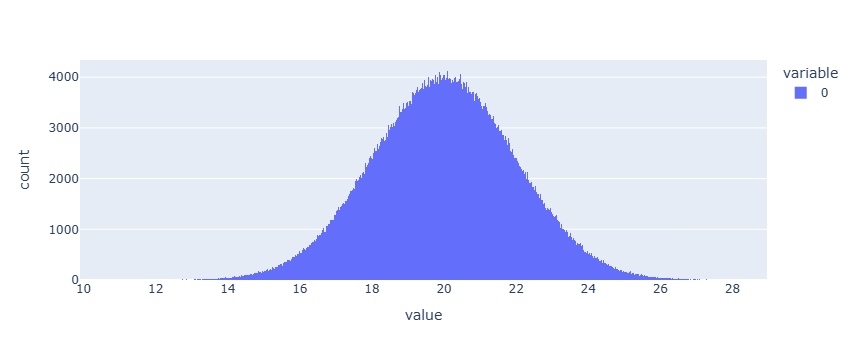

In [76]:
# random 함수를 활용해 정규분포
n1 = np.random.normal(20, 2, 1000000) # 평균이 20이고 표준편차가 2인 10개의 무작위 데이터를 생성

# histogram 활용 시각화
px.histogram(n1)

Q1. 새로 출시된 어플리케이션에서, 신규 고객이 계좌를 새로 개설하는데 걸리는 시간을 측정한 결과 평균 15분, (표준편차 4분) 소요됨을 파악했다.  해당 데이터가 정규분포를 따른다면, 신규계좌개설에 걸리는 시간이 20분 이상인 고객들의 비율은 몇 %인가?

In [78]:
# 평균 개설 시간
mean1 = 15
# 표준편차
std1 = 4
# 알고자하는 시간
x = 20
# 누적 확률(cumulative distribution function, cdf) # 해당 분포 값 까지의 누적된 확률값
1 - stats.norm.cdf(x, mean1, std1)

np.float64(0.10564977366685535)

**계수형 확률 분포**

- 이산(계수형)형 값을 취하는 상황을 모형화 하기 위해 사용
- 예를 들면, 제품의 분량여부 조사한 데이터, 마케팅 성공 여부, 계약 여부
- 계수형 확률 분포는 확률질량함수(pmf)로 계산
  - **이항 분포(Binomial Distribution)** : 실험의 결과(측정된 데이터)가 양/불량, 성공/실패, 등 두 가지로만 구분되는 시행(베르누이 시행)을 n번에 걸쳐 반복햇을 때, 성공횟수 x가 따르는 분포
  - **포아송 분포(Poisson Distribution)** : 연속적인 시간이나 공간에서 발생 빈도가 낮은 희귀한 사건의 단위 당 발생 수에 적용되는 분포
    - 일정 시간 동안 걸려오는 고객 VOC 전화, 분의 수
    - 단위 면적 당 발생한 흠집의 갯수
    - 일정 시간동안 은행 창구를 찾는 고객 수

- 이항분포 기댓값 계산 문제
- Q2. A사의 금융상품 해약율이 15%나 된다고 했을 때, 3명의 고객을 임의로 선택했을 때, 해약 고객이 각각 0명, 1명, 2명, 3명 확률을 계산

In [79]:
for i in range(4):
    # 이항 분포 질량함수 계산
    prob = stats.binom.pmf(k = i, n = 3, p = 0.15)
    print(i, prob.round(3))

0 0.614
1 0.325
2 0.057
3 0.003


- 포아송 분포 기댓값 계산 문제
- Q3. 한 은행의 고객선터에 하루 평균 5번의 스마트 뱅크 이용관련 VOC가 발생한다고 가정, 특정 시간동안 VOC가 발생하지 않을 확률 계산

In [80]:
voc_days = 5 # 하루 평균 5회의 VOC가 발생
time1 = 2 # 기간 (하루 단위) 2일동안 VOC가 발생하지 않을 확률 계산
new_voc = 0 # VOC가 발생하지 않음

stats.poisson.pmf(new_voc, voc_days * time1)

np.float64(4.5399929762484854e-05)

In [81]:
stats.poisson.pmf(new_voc, voc_days * 0.5) # 반나절

np.float64(0.0820849986238988)

## 10-2. 추론 통계 (Inferencial Statistics)

- 기술 통계 (Descriptive Statistic) : 수집된 데이터로부터 평균, 분산등의 요약 통계량을 계산해, 해당 통계량의 직접적인 특성을 파악
- 추론 통계 : 표본에 포함된 정보로부터 모집단의 특성을 파악하고 타당성을 검토하여 모수(모집단의 통계량)추론하거나 예측
- 추론 통계 활용 :
  - 통계적 추정 (Estimation) : 표본의 성격을 나타내는 통계량(모집단의 평균, 분포의 모양)을 기초로 모수(모집단의 통계량)을 추정
  - 가설 검정 (Hypothesis Test) : 모수에 대해 특정한 가설을 세워놓고, 표본을 선택하여 통계량을 계산한 다음, 이를 기초로 모수의 대한 가설의 진위여부를 판별 (CDA)
- 추론 이론:
  - 모수 (Parameter) : 모집단(Population)의 기술적 척도, 모집단의 통계량
  - 통계량 (Statistic) : 표본(Sample)의 기술적 척도
  - 표본과 모집단은 같지 않으므로, 표본으로 구해지는 결론과 추정값들은 항상 옳은 것이 아님
  - 신뢰 수준 (Confidence level), 유의 수준 (Significance level)
    - 신뢰 구간 (Confidence interval, ci) : 오차를 a로 두고 같은 크기의 표본을 여러차례 추출할 때, 참값을 포함할 가능성이 있는 구간
    - 1 - a : 신뢰 수준 -> 구간 추정에서 제시된 구간이 모수를 포함할 확률
    - 오차를 5%, 신뢰수준이 95% -> 지정된 범위 내 모수가 포함될 확률이 95%정도 된다.
    - A 클래스 내 데이터 -> 3.2 ~ 4.5점, 오차 5%
    - 학원 전체의 학점 평균이 95% 확률로 3.2 ~ 4.5사이에 포함되어 있다. (구간추정)

## 10-3. 통계적 가설 검정

- 통계적 가설 검정 : 규명하고자 하는 바를 가설로 수립하여, 해당 가설이 참인지 거짓인지 객관적인 값으로 규명하는 작업
- 가설 (하나 또는 그 이상의 모집단에 대한 모수의 진술):
  - 귀무 가설 (보통 가설)
    - 현재까지 주장되어 온 것이거나, 기존의 변화에 대한 차이가 없음을 설명하는 가설
    - 기각 시킬 목적으로 수립하는 가설 (대립 가설의 반대)
    - 보통 상황, 일반적인 상황에 대한 가설
      - 통계적인 관점에서 일반적인 상황
      - 수집된 표본은 서로 독립이다
      - 서로 독립 -> 두 데이터가 서로 연관성이 없다.
    - 따라서 다음과 같은 표현들이 사용:
      - 집단 간의 평균이 같다, 두 데이터가 연관성이 없다, 두 데이터는 서로 독립이다
      - 두 데이터는 서로 상관성이 없다, 비례 반비례 관계가 아니다, 정규분포를 따른다

  - 대립 가설
    - 새로이 주장하는 것, 기존과 다른 주장을 설명하는 가설
    - 채택을 목적으로 수립하는 가설 (귀무 가설의 반대)
    - 따라서 다음과 같은 표현들이 사용:
      - 집단 간의 평균이 차이가 있다, 두 데이터가 서로 연관성이 있다, 두 데이터는 서로 독립이 아니다
      - 비례 반비례 관계가 있다, 정규분포를 따르지 않는다.
- 객관적인 값 : P.value (확률값) - 확률 분포로부터 계산되는 값
- 가설 검정의 근간 (통계적 관점에서의 일반상황, 보통상황)
  1. 수집된 데이터는 서로 독립적으로 수집되었다.
  2. 표본은 하나의 모잡단에서 추출된 것이다.
  3. 두 개의 표본은 하나의 모집단에서 추출된 것이다.
- 예) 20대와 30대의 주당 방문횟수의 차이가 있는가?
  - 귀무가설: 20대와 30대의 주당방문횟수의 차이는 없다.
  - 대립가설: 20대와 30대의 주당방문횟수의 차이는 있다.
- P.value (확률값) : 귀무가설이 참일 확률(0 ~ 100%)
- 유의 수준: 가설 검정의 판단 기준(5%, 0.05)
  - P.value < 0.05 : 대립가설이 참 (귀무가설 기각)
  - P.value > 0.05 : 귀무가설이 참 (귀무가설 기각 실패)
- Risk : 실제로 가설검증을 수행하게 되면, 가설검정의 결과가 실제 벌어지는 상황과 다른 경우가 발생
  - 이유는 가설검정이 현재 수집된 데이터를 표본으로 가정하고, 모집단을 추정해 가설이 참인지 거짓인지를 결론내리기 때문
  - 이 때문에 가설 검정에는 2가지의 Risk 존재
    - α risk (1종 오류) : 가설 검정의 결과는 대립가설이 채택 됐으나, 실제로는 귀무가설이 참
    - β risk (2종 오류) : 가설 검정의 결과는 귀무가설이 채택 됐으나, 실제로는 대립가설이 참
    - 예시) 생산된 A제품이 불량일 것인지?
      - 귀무가설 : 제품은 불량이 아니다, 정상이다.
      - 대립가설 : 제품은 불량이다, 정상이 아니다.
      - 1종 오류 -> 해당 제품을 불량으로 판별했지만 실제로는 불량이 아님(정상) -> 생산자 위험
      - 2종 오류 -> 해당 제품을 정상으로 판별했지만 실제로는 불량 (불량) -> 소비자 위험
    - Power of the Test (검정력) : 대립가설이 참인 경우, 대립가설을 올바르게 판별할 확률
      - Power 높으면, 문제가 발생하지 않음 -> 비용이 발생